Per Q13 request: The best model is XGBoost with hyperparameter tuning, with test score 0.535 (f1-score).

In [1]:
# Initialize Otter
import otter
grader = otter.Notebook("lab4.ipynb")

# Lab 4: Putting it all together in a mini project

For this lab, **you can choose to work alone of in a group of up to four students**. You are in charge of how you want to work and who you want to work with. Maybe you really want to go through all the steps of the ML process yourself or maybe you want to practice your collaboration skills, it is up to you! Just remember to indicate who your group members are (if any) when you submit on Gradescope. If you choose to work in a group, you only need to use one GitHub repo (you can create one on github.ubc.ca and set the visibility to "public"). If it takes a prohibitively long time to run any of the steps on your laptop, it is OK if you sample the data to reduce the runtime, just make sure you write a note about this.

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## Submission instructions
rubric={mechanics}

<p>You receive marks for submitting your lab correctly, please follow these instructions:</p>

<ul>
  <li><a href="https://ubc-mds.github.io/resources_pages/general_lab_instructions/">
      Follow the general lab instructions.</a></li>
  <li><a href="https://github.com/UBC-MDS/public/tree/master/rubric">
      Click here to view a description of the rubrics used to grade the questions</a></li>
  <li>Make at least three commits.</li>
  <li>Push your <code>.ipynb</code> file to your GitHub repository for this lab and upload it to Gradescope.</li>
    <ul>
      <li>Before submitting, make sure you restart the kernel and rerun all cells.</li>
    </ul>
  <li>Also upload a <code>.pdf</code> export of the notebook to facilitate grading of manual questions (preferably WebPDF, you can select two files when uploading to gradescope)</li>
  <li>Don't change any variable names that are given to you, don't move cells around, and don't include any code to install packages in the notebook.</li>
  <li>The data you download for this lab <b>SHOULD NOT BE PUSHED TO YOUR REPOSITORY</b> (there is also a <code>.gitignore</code> in the repo to prevent this).</li>
  <li>Include a clickable link to your GitHub repo for the lab just below this cell
    <ul>
      <li>It should look something like this https://github.ubc.ca/MDS-2020-21/DSCI_531_labX_yourcwl.</li>
    </ul>
  </li>
</ul>
</div>

_Points:_ 2

https://github.ubc.ca/mds-2024-25/creditcardclassifier_course_feateng/

<!-- END QUESTION -->

## Introduction <a name="in"></a>

In this lab you will be working on an open-ended mini-project, where you will put all the different things you have learned so far in 571 and 573 together to solve an interesting problem.

A few notes and tips when you work on this mini-project: 

#### Tips
1. Since this mini-project is open-ended there might be some situations where you'll have to use your own judgment and make your own decisions (as you would be doing when you work as a data scientist). Make sure you explain your decisions whenever necessary. 
2. **Do not include everything you ever tried in your submission** -- it's fine just to have your final code. That said, your code should be reproducible and well-documented. For example, if you chose your hyperparameters based on some hyperparameter optimization experiment, you should leave in the code for that experiment so that someone else could re-run it and obtain the same hyperparameters, rather than mysteriously just setting the hyperparameters to some (carefully chosen) values in your code. 
3. If you realize that you are repeating a lot of code try to organize it in functions. Clear presentation of your code, experiments, and results is the key to be successful in this lab. You may use code from lecture notes or previous lab solutions with appropriate attributions. 

#### Assessment
We don't have some secret target score that you need to achieve to get a good grade. **You'll be assessed on demonstration of mastery of course topics, clear presentation, and the quality of your analysis and results.** For example, if you just have a bunch of code and no text or figures, that's not good. If you instead do a bunch of sane things and you have clearly motivated your choices, but still get lower model performance than your friend, don't sweat it.


#### A final note
Finally, the style of this "project" question is different from other assignments. It'll be up to you to decide when you're "done" -- in fact, this is one of the hardest parts of real projects. But please don't spend WAY too much time on this... perhaps "several hours" but not "many hours" is a good guideline for a high quality submission. Of course if you're having fun you're welcome to spend as much time as you want! But, if so, try not to do it out of perfectionism or getting the best possible grade. Do it because you're learning and enjoying it. Students from the past cohorts have found such kind of labs useful and fun and we hope you enjoy it as well. 

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## 1. Pick your problem and explain the prediction problem <a name="1"></a>
rubric={reasoning}

In this mini project, you will pick one of the following problems: 

1. A classification problem of predicting whether a credit card client will default or not. For this problem, you will use [Default of Credit Card Clients Dataset](https://www.kaggle.com/uciml/default-of-credit-card-clients-dataset). In this data set, there are 30,000 examples and 24 features, and the goal is to estimate whether a person will default (fail to pay) their credit card bills; this column is labeled "default.payment.next.month" in the data. The rest of the columns can be used as features. You may take some ideas and compare your results with [the associated research paper](https://www.sciencedirect.com/science/article/pii/S0957417407006719), which is available through [the UBC library](https://www.library.ubc.ca/). 

OR 

2. A regression problem of predicting `reviews_per_month`, as a proxy for the popularity of the listing with [New York City Airbnb listings from 2019 dataset](https://www.kaggle.com/dgomonov/new-york-city-airbnb-open-data). Airbnb could use this sort of model to predict how popular future listings might be before they are posted, perhaps to help guide hosts create more appealing listings. In reality they might instead use something like vacancy rate or average rating as their target, but we do not have that available here.

**Your tasks:**

1. Spend some time understanding the problem and what each feature means. Write a few sentences on your initial thoughts on the problem and the dataset. 
2. Download the dataset and read it as a pandas dataframe. 
3. Carry out any preliminary preprocessing, if needed (e.g., changing feature names, handling of NaN values etc.)
    
</div>

_Points:_ 3

**We chose the Classification Problem:**
- The dataset focuses on predicting whether a credit card client with 30000 data that will default on their payment based on demographic, credit, and payment history information.
- The target variable is default.payment.next.month, with a binary classification (1 for default, 0 for non-default).
- There are 24 features providing diverse insights, including demographic attributes (e.g., SEX, EDUCATION, MARRIAGE, AGE), credit details (LIMIT_BAL), and detailed payment history (e.g., PAY_0, BILL_AMT1-6, PAY_AMT1-6).

In [2]:
import pandas as pd
df = pd.read_csv("data/UCI_Credit_Card.csv")

In [3]:
df.info

<bound method DataFrame.info of           ID  LIMIT_BAL  SEX  EDUCATION  MARRIAGE  AGE  PAY_0  PAY_2  PAY_3  \
0          1    20000.0    2          2         1   24      2      2     -1   
1          2   120000.0    2          2         2   26     -1      2      0   
2          3    90000.0    2          2         2   34      0      0      0   
3          4    50000.0    2          2         1   37      0      0      0   
4          5    50000.0    1          2         1   57     -1      0     -1   
...      ...        ...  ...        ...       ...  ...    ...    ...    ...   
29995  29996   220000.0    1          3         1   39      0      0      0   
29996  29997   150000.0    1          3         2   43     -1     -1     -1   
29997  29998    30000.0    1          2         2   37      4      3      2   
29998  29999    80000.0    1          3         1   41      1     -1      0   
29999  30000    50000.0    1          2         1   46      0      0      0   

       PAY_4  ...  

<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## 2. Data splitting <a name="2"></a>
rubric={reasoning}

**Your tasks:**

1. Split the data into train and test portions.

> Make the decision on the `test_size` based on the capacity of your laptop. 
    
</div>

_Points:_ 1

In [4]:
from sklearn.model_selection import train_test_split

train_df, test_df = train_test_split(df, test_size=0.2, random_state=573)

X_train = train_df.drop(columns='default.payment.next.month')
y_train = train_df['default.payment.next.month']
X_test = test_df.drop(columns='default.payment.next.month')
y_test = test_df['default.payment.next.month']

train_df

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
7359,7360,20000.0,1,3,1,49,0,0,0,0,...,10790.0,390.0,780.0,1218.0,1285.0,608.0,390.0,780.0,0.0,0
16848,16849,20000.0,1,3,2,40,0,0,0,0,...,19800.0,20000.0,0.0,1291.0,1478.0,1200.0,400.0,0.0,0.0,0
29592,29593,30000.0,1,1,2,49,0,0,0,2,...,28277.0,20390.0,20555.0,1500.0,4500.0,0.0,900.0,1000.0,2000.0,0
20636,20637,100000.0,1,3,2,30,0,0,0,0,...,87919.0,75386.0,69410.0,3435.0,4608.0,25140.0,2566.0,2375.0,4621.0,0
26275,26276,280000.0,2,1,1,37,-1,-1,-1,-1,...,1028.0,889.0,698.0,168.0,786.0,1028.0,698.0,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8144,8145,50000.0,1,1,2,23,0,0,2,2,...,16894.0,17667.0,19211.0,3600.0,1400.0,0.0,1200.0,2000.0,1000.0,0
14870,14871,150000.0,1,1,2,44,1,2,-1,-1,...,56800.0,54588.0,-7.0,137.0,15800.0,56800.0,0.0,7.0,79447.0,0
29361,29362,310000.0,1,3,2,28,-1,2,-1,-1,...,653.0,14353.0,15932.0,0.0,3567.0,654.0,14428.0,15018.0,20000.0,0
9822,9823,20000.0,1,3,2,49,0,0,0,-1,...,19413.0,12223.0,2110.0,1200.0,160.0,20394.0,347.0,2110.0,12996.0,0


<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## 3. EDA <a name="3"></a>
rubric={viz,reasoning}
    
Perform exploratory data analysis on the train set.

**Your tasks:**

1. Include at least two summary statistics and two visualizations that you find useful, and accompany each one with a sentence explaining it.
2. Summarize your initial observations about the data. 
3. Pick appropriate metric/metrics for assessment. 
    
</div>

_Points:_ 6

**Dataset Overview:**
- ID: Ranges from 1 to 30,000, representing 30,000 entries.  
- LIMIT_BAL (Credit Limit): Ranges from 10,000 to 1,000,000, with a mean of 167,484. The distribution is highly skewed (high standard deviation of 129,747).  
- SEX: Binary (1 = male, 2 = female), with more females (mean of 1.60).  
- EDUCATION: Categories from 0 to 6, with some unclear categories (5 and 6), which may need to be recategorized.  
- MARRIAGE: Categories 0, 1, 2, and 3, where 0 likely represents unknown data.  
- AGE: Ranges from 21 to 79, with a mean of 35.48. Most clients are in their 20s to 40s.

**Key Columns:**
- Repayment History (PAY_0 to PAY_6): Values range from -2 to 8, suggesting special codes and a variety of repayment behaviors. The high standard deviations indicate significant repayment delays and variances in customer behavior.  
- Bill Amounts (BILL_AMT1 to BILL_AMT6): Wide range from negative values (possibly refunds) to amounts nearing a million. Most values are concentrated in lower ranges, with outliers at the high end.  
- Payment Amounts (PAY_AMT1 to PAY_AMT6): Wide variation, with amounts up to 1.68 million. Mean values are under 6,000, but extreme outliers are present.  
- Target Variable (default.payment.next.month): Binary (0 = no default, 1 = default), with a mean of 0.22, indicating ~22% defaulters. This suggests class imbalance in the dataset.

**Correlation Analysis:**
- Pearson Correlation: Strong positive correlations between the BILL_AMT features (1 to 6) and between the PAY_0 to PAY_6 repayment features, indicating consistency over time.  
- Spearman Correlation: Similar to Pearson, but captures non-linear monotonic relationships. The strong relationships between BILL_AMT and PAY_AMT features and repayment history suggest the importance of these features for predicting defaults.

**Key Insights:**
- Predictor Importance: Payment amounts, bill amounts, and repayment statuses are critical features for distinguishing defaulters from non-defaulters.  
- Skewness: Most numeric features are right-skewed.
- Weak Predictors: Features like AGE, SEX, EDUCATION, and MARRIAGE may have limited predictive power for default prediction.

**Class Imbalance:**
- The dataset exhibits a significant class imbalance, with only 22% of the observations labeled as defaulters (5282 vs 18718). Techniques like oversampling, undersampling, or class weights may be necessary to address this imbalance.
- Since there are class imbalance, the F1-score is suggested to be scoring metrics for considering to capture both Precision and Recall.

In [5]:
df.nunique()

ID                            30000
LIMIT_BAL                        81
SEX                               2
EDUCATION                         7
MARRIAGE                          4
AGE                              56
PAY_0                            11
PAY_2                            11
PAY_3                            11
PAY_4                            11
PAY_5                            10
PAY_6                            10
BILL_AMT1                     22723
BILL_AMT2                     22346
BILL_AMT3                     22026
BILL_AMT4                     21548
BILL_AMT5                     21010
BILL_AMT6                     20604
PAY_AMT1                       7943
PAY_AMT2                       7899
PAY_AMT3                       7518
PAY_AMT4                       6937
PAY_AMT5                       6897
PAY_AMT6                       6939
default.payment.next.month        2
dtype: int64

In [6]:
df.head()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
0,1,20000.0,2,2,1,24,2,2,-1,-1,...,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
1,2,120000.0,2,2,2,26,-1,2,0,0,...,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1
2,3,90000.0,2,2,2,34,0,0,0,0,...,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0
3,4,50000.0,2,2,1,37,0,0,0,0,...,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,0
4,5,50000.0,1,2,1,57,-1,0,-1,0,...,20940.0,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0,0


In [7]:
df.describe()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
count,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,...,30000.000000,30000.000000,30000.000000,30000.000000,3.000000e+04,30000.00000,30000.000000,30000.000000,30000.000000,30000.000000
mean,15000.500000,167484.322667,1.603733,1.853133,1.551867,35.485500,-0.016700,-0.133767,-0.166200,-0.220667,...,43262.948967,40311.400967,38871.760400,5663.580500,5.921163e+03,5225.68150,4826.076867,4799.387633,5215.502567,0.221200
std,8660.398374,129747.661567,0.489129,0.790349,0.521970,9.217904,1.123802,1.197186,1.196868,1.169139,...,64332.856134,60797.155770,59554.107537,16563.280354,2.304087e+04,17606.96147,15666.159744,15278.305679,17777.465775,0.415062
min,1.000000,10000.000000,1.000000,0.000000,0.000000,21.000000,-2.000000,-2.000000,-2.000000,-2.000000,...,-170000.000000,-81334.000000,-339603.000000,0.000000,0.000000e+00,0.00000,0.000000,0.000000,0.000000,0.000000
25%,7500.750000,50000.000000,1.000000,1.000000,1.000000,28.000000,-1.000000,-1.000000,-1.000000,-1.000000,...,2326.750000,1763.000000,1256.000000,1000.000000,8.330000e+02,390.00000,296.000000,252.500000,117.750000,0.000000
50%,15000.500000,140000.000000,2.000000,2.000000,2.000000,34.000000,0.000000,0.000000,0.000000,0.000000,...,19052.000000,18104.500000,17071.000000,2100.000000,2.009000e+03,1800.00000,1500.000000,1500.000000,1500.000000,0.000000
75%,22500.250000,240000.000000,2.000000,2.000000,2.000000,41.000000,0.000000,0.000000,0.000000,0.000000,...,54506.000000,50190.500000,49198.250000,5006.000000,5.000000e+03,4505.00000,4013.250000,4031.500000,4000.000000,0.000000
max,30000.000000,1000000.000000,2.000000,6.000000,3.000000,79.000000,8.000000,8.000000,8.000000,8.000000,...,891586.000000,927171.000000,961664.000000,873552.000000,1.684259e+06,896040.00000,621000.000000,426529.000000,528666.000000,1.000000


**From the above statistics:**
- ID ranges: from 1 to 30,000 (as expected for 30,000 entries).
- LIMIT_BAL: (credit limit) has a wide range (10,000 to 1,000,000). The mean is 167,484, and the distribution is skewed (evidenced by the high standard deviation of 129,747).
- SEX: Binary, with values 1 and 2 (likely 1 = male, 2 = female). Most clients are female (mean 1.60 suggests more 2s than 1s).
- EDUCATION: Categories range from 0 to 6. The 5, and 6 suggests is unknown categories, which might need to be modified.
- MARRIAGE: Categories 0, 1, 2, and 3.
- AGE: Clients are aged 21 to 79, with a mean of 35.48. The age distribution appears relatively concentrated around the 20s to 40s.
- Repayment History (PAY_0 to PAY_6):
These columns indicate repayment status, with values ranging from -2 to 8. Negative values might represent special codes like "paid in full" or "no consumption."
The mean values are near zero, but high standard deviations suggest a wide variety of repayment behaviors, including significant delays (values 7 and 8).
- Bill Statements (BILL_AMT1 to BILL_AMT6):
Amounts range from large negative values (possibly refunds) to nearly a million.
The mean and standard deviation suggest most values are concentrated in the lower range, but there are outliers at the high end.
- Payment Amounts (PAY_AMT1 to PAY_AMT6):
The amounts vary widely (0 to as high as 1.68 million), with mean values under 6,000. These columns have extreme outliers that might need attention during preprocessing.
- Target Variable (default.payment.next.month):
Binary, with a mean of 0.22, indicating ~22% of clients defaulted. This is a class-imbalanced dataset, and methods to address this imbalance (e.g., oversampling, undersampling, or class weights) may be necessary.

In [8]:
import altair_ally as aly

aly.corr(train_df)

alt.ConcatChart(...)

**From the above Pearson correlation graph:**
- We can see that the BILL_AMT1 to BILL_AMT6 has a lot of positive correlations.
- We can also see a pretty strong correlation between PAY_0 to PAY_6.  

**From the above Spearman correlation graph:**
- Similar patterns as Pearson but accounting for non-linear monotonic relationships. Strong relationships still appear between BILL_AMT features and between PAY_AMT features.
PAY_0 to PAY_6 are positively correlated with each other, implying consistency in repayment behavior over months.

In [9]:
subset_df = train_df[['LIMIT_BAL',
                      'SEX',
                      'EDUCATION',
                      'MARRIAGE',
                      'AGE','PAY_0',
                      'PAY_2',
                      'PAY_3',
                      'PAY_4',
                      'PAY_5',
                      'PAY_6',
                      'BILL_AMT1',
                      'BILL_AMT2',
                      'BILL_AMT3',
                      'BILL_AMT4',
                      'BILL_AMT5',
                      'BILL_AMT6',
                      'PAY_AMT1',
                      'PAY_AMT2',
                      'PAY_AMT3',
                      'PAY_AMT4',
                      'PAY_AMT5',
                      'PAY_AMT6',
                      'default.payment.next.month']]
subset_df['target'] = subset_df['default.payment.next.month'].astype(bool)
subset_df = subset_df.drop(columns='default.payment.next.month')


aly.alt.data_transformers.enable('vegafusion')

aly.dist(subset_df, color = 'target')


alt.ConcatChart(...)

**From the above graphs:**
- Predictor Importance: Payment amounts, bill amounts, and repayment statuses are crucial features distinguishing defaulters from non-defaulters.
- Skewness: Most numeric features are right-skewed.
- Weak Predictors: Features like AGE, SEX, EDUCATION, and MARRIAGE might have limited utility for prediction.

In [10]:
train_df

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
7359,7360,20000.0,1,3,1,49,0,0,0,0,...,10790.0,390.0,780.0,1218.0,1285.0,608.0,390.0,780.0,0.0,0
16848,16849,20000.0,1,3,2,40,0,0,0,0,...,19800.0,20000.0,0.0,1291.0,1478.0,1200.0,400.0,0.0,0.0,0
29592,29593,30000.0,1,1,2,49,0,0,0,2,...,28277.0,20390.0,20555.0,1500.0,4500.0,0.0,900.0,1000.0,2000.0,0
20636,20637,100000.0,1,3,2,30,0,0,0,0,...,87919.0,75386.0,69410.0,3435.0,4608.0,25140.0,2566.0,2375.0,4621.0,0
26275,26276,280000.0,2,1,1,37,-1,-1,-1,-1,...,1028.0,889.0,698.0,168.0,786.0,1028.0,698.0,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8144,8145,50000.0,1,1,2,23,0,0,2,2,...,16894.0,17667.0,19211.0,3600.0,1400.0,0.0,1200.0,2000.0,1000.0,0
14870,14871,150000.0,1,1,2,44,1,2,-1,-1,...,56800.0,54588.0,-7.0,137.0,15800.0,56800.0,0.0,7.0,79447.0,0
29361,29362,310000.0,1,3,2,28,-1,2,-1,-1,...,653.0,14353.0,15932.0,0.0,3567.0,654.0,14428.0,15018.0,20000.0,0
9822,9823,20000.0,1,3,2,49,0,0,0,-1,...,19413.0,12223.0,2110.0,1200.0,160.0,20394.0,347.0,2110.0,12996.0,0


In [11]:
scoring_metric = "f1"
subset_df['target'].value_counts()

target
False    18718
True      5282
Name: count, dtype: int64

In [12]:
import altair as alt

alt.Chart(subset_df).mark_bar().encode(
    x=alt.X('target:O', title='Target'),
    y=alt.Y('count()', title='Count'),
    color='target:N'
).properties(
    width=500,
    height=300,
    title='Count of Target'
)

alt.Chart(...)

**Based on the above observations of Target Distribution in Dataset:**
- We can see from the plot above that the amount of people with default and no default payment next month is imbalanced.
- Since there are class imbalance, the F1-score is suggested to be scoring metrics for considering to capture both Precision and Recall.

<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-warning">

## 4. Feature engineering (Challenging)
rubric={reasoning}

**Your tasks:**

1. Carry out feature engineering. In other words, extract new features relevant for the problem and work with your new feature set in the following exercises. You may have to go back and forth between feature engineering and preprocessing.
    
</div>

_Points:_ 0.5

In [13]:
## New Feature 1:
# age categories: 18-24, 25-34, 35-44, 45-54, 55-64, and 65 and older. 
# source: https://www.pickfu.com/demographic-segmentation

bins = [0, 24, 34, 44, 54, 64, float('inf')]  
labels = ['18-24', '25-34', '35-44', '45-54', '55-64', '65 and older'] 

X_train["AGE_CATEGORY"] = pd.cut(X_train['AGE'], bins=bins, labels=labels, right=True)

# Example for age groups
age_mapping = {
    '18-24': 1,
    '25-34': 2,
    '35-44': 3,
    '45-54': 4, 
    '55-64': 5, 
    '65 and older': 6
    # Add more mappings as needed
}
X_train['AGE_CATEGORY'] = X_train['AGE_CATEGORY'].map(age_mapping)


## New Feature 2:
#BillPayDiff is the difference between bill amount and pay amount
X_train['BILLPAYDIFF_AMT1'] =X_train['BILL_AMT1'] - X_train['PAY_AMT1']
X_train['BILLPAYDIFF_AMT2'] =X_train['BILL_AMT2'] - X_train['PAY_AMT2']
X_train['BILLPAYDIFF_AMT3'] =X_train['BILL_AMT3'] - X_train['PAY_AMT3']
X_train['BILLPAYDIFF_AMT4'] =X_train['BILL_AMT4'] - X_train['PAY_AMT4']
X_train['BILLPAYDIFF_AMT5'] =X_train['BILL_AMT5'] - X_train['PAY_AMT5']
X_train['BILLPAYDIFF_AMT6'] =X_train['BILL_AMT6'] - X_train['PAY_AMT6']


##Adding the same New Features to X_test
#Feature 1
X_test["AGE_CATEGORY"] = pd.cut(X_test['AGE'], bins=bins, labels=labels, right=True)
age_mapping = {
    '18-24': 1,
    '25-34': 2,
    '35-44': 3,
    '45-54': 4, 
    '55-64': 5, 
    '65 and older': 6
    # Add more mappings as needed
}
X_test['AGE_CATEGORY'] = X_test['AGE_CATEGORY'].map(age_mapping)
#Feature 2
X_test['BILLPAYDIFF_AMT1'] =X_test['BILL_AMT1'] - X_test['PAY_AMT1']
X_test['BILLPAYDIFF_AMT2'] =X_test['BILL_AMT2'] - X_test['PAY_AMT2']
X_test['BILLPAYDIFF_AMT3'] =X_test['BILL_AMT3'] - X_test['PAY_AMT3']
X_test['BILLPAYDIFF_AMT4'] =X_test['BILL_AMT4'] - X_test['PAY_AMT4']
X_test['BILLPAYDIFF_AMT5'] =X_test['BILL_AMT5'] - X_test['PAY_AMT5']
X_test['BILLPAYDIFF_AMT6'] =X_test['BILL_AMT6'] - X_test['PAY_AMT6']

X_train

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,PAY_AMT4,PAY_AMT5,PAY_AMT6,AGE_CATEGORY,BILLPAYDIFF_AMT1,BILLPAYDIFF_AMT2,BILLPAYDIFF_AMT3,BILLPAYDIFF_AMT4,BILLPAYDIFF_AMT5,BILLPAYDIFF_AMT6
7359,7360,20000.0,1,3,1,49,0,0,0,0,...,390.0,780.0,0.0,4,12663.0,10885.0,12629.0,10400.0,-390.0,780.0
16848,16849,20000.0,1,3,2,40,0,0,0,0,...,400.0,0.0,0.0,3,15593.0,16413.0,17878.0,19400.0,20000.0,0.0
29592,29593,30000.0,1,1,2,49,0,0,0,2,...,900.0,1000.0,2000.0,4,23644.0,21331.0,29122.0,27377.0,19390.0,18555.0
20636,20637,100000.0,1,3,2,30,0,0,0,0,...,2566.0,2375.0,4621.0,2,88783.0,73458.0,52100.0,85353.0,73011.0,64789.0
26275,26276,280000.0,2,1,1,37,-1,-1,-1,-1,...,698.0,0.0,0.0,3,565.0,-618.0,-242.0,330.0,889.0,698.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8144,8145,50000.0,1,1,2,23,0,0,2,2,...,1200.0,2000.0,1000.0,1,11736.0,17281.0,19463.0,15694.0,15667.0,18211.0
14870,14871,150000.0,1,1,2,44,1,2,-1,-1,...,0.0,7.0,79447.0,3,10573.0,-10818.0,-56000.0,56800.0,54581.0,-79454.0
29361,29362,310000.0,1,3,2,28,-1,2,-1,-1,...,14428.0,15018.0,20000.0,2,186.0,-3381.0,2896.0,-13775.0,-665.0,-4068.0
9822,9823,20000.0,1,3,2,49,0,0,0,-1,...,347.0,2110.0,12996.0,4,18163.0,19449.0,-20785.0,19066.0,10113.0,-10886.0


<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## 5. Preprocessing and transformations <a name="5"></a>
rubric={accuracy,reasoning}

**Your tasks:**

1. Identify different feature types and the transformations you would apply on each feature type. 
2. Define a column transformer, if necessary. 
    
</div>

_Points:_ 4

In [14]:
from sklearn.preprocessing import OneHotEncoder,StandardScaler, OrdinalEncoder
from sklearn.compose import make_column_transformer


drop_features = ["ID"]
numeric_features = ['LIMIT_BAL',
                      'AGE',
                      'PAY_0',
                      'PAY_2',
                      'PAY_3',
                      'PAY_4',
                      'PAY_5',
                      'PAY_6',
                      'BILL_AMT1',
                      'BILL_AMT2',
                      'BILL_AMT3',
                      'BILL_AMT4',
                      'BILL_AMT5',
                      'BILL_AMT6',
                      'PAY_AMT1',
                      'PAY_AMT2',
                      'PAY_AMT3',
                      'PAY_AMT4',
                      'PAY_AMT5',
                      'PAY_AMT6', 
                      "BILLPAYDIFF_AMT1", 
                      "BILLPAYDIFF_AMT2", 
                      "BILLPAYDIFF_AMT3", 
                      "BILLPAYDIFF_AMT4", 
                      "BILLPAYDIFF_AMT5", 
                      "BILLPAYDIFF_AMT6"]


categorical_features = ["EDUCATION", "MARRIAGE", 'SEX']

ordinal_feautres = ["AGE_CATEGORY"]
age_category_order = ["1", "2", "3", "4", "5", "6"] 


preprocessor = make_column_transformer(    
    (StandardScaler(), numeric_features),  
    (OneHotEncoder(drop = 'if_binary', sparse_output=False), categorical_features), 
    (OrdinalEncoder(categories=[age_category_order]), ordinal_feautres), 
    ("drop", drop_features),  
)

preprocessor

ColumnTransformer(transformers=[('standardscaler', StandardScaler(),
                                 ['LIMIT_BAL', 'AGE', 'PAY_0', 'PAY_2', 'PAY_3',
                                  'PAY_4', 'PAY_5', 'PAY_6', 'BILL_AMT1',
                                  'BILL_AMT2', 'BILL_AMT3', 'BILL_AMT4',
                                  'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1',
                                  'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4',
                                  'PAY_AMT5', 'PAY_AMT6', 'BILLPAYDIFF_AMT1',
                                  'BILLPAYDIFF_AMT2', 'BILLPAYDIFF_AMT3',
                                  'BILLPAYDIFF_AMT4', 'BILLPAYDIFF_AMT5',
                                  'BILLPAYDIFF_AMT6']),
                                ('onehotencoder',
                                 OneHotEncoder(drop='if_binary',
                                               sparse_output=False),
                                 ['EDUCATION', 'MARRIAGE', 'SEX']),
                                ('ordinalencoder',
                                 OrdinalEncoder(categories=[['1', '2', '3', '4',
                                                             '5', '6']]),
                                 ['AGE_CATEGORY']),
                                ('drop', 'drop', ['ID'])])

<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## 6. Baseline model <a name="6"></a>
rubric={accuracy}

**Your tasks:**
1. Train a baseline model for your task and report its performance.
    
</div>

_Points:_ 2

The baseline model is DummyClassifier model. The test score (F1) of the baseline model is 0.000. The training score has the same score as well. It indicates the model is unable to predict correctly in this imbalanced dataset.

In [15]:
result = {}

In [16]:
from sklearn.dummy import DummyClassifier, DummyRegressor
from sklearn.model_selection import cross_validate

result['DummyRegressor'] = pd.DataFrame(cross_validate(DummyClassifier(strategy="stratified"), 
                                                       X_train, y_train, 
                                                       scoring=scoring_metric,  
                                                       return_train_score=True)).agg(['mean', 'std']).round(3).T

# Show the train and validation scores
result['DummyRegressor']

,mean,std
fit_time,0.004,0.001
score_time,0.004,0.001
test_score,0.223,0.004
train_score,0.223,0.003


<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## 7. Linear models <a name="7"></a>
rubric={accuracy,reasoning}

**Your tasks:**

1. Try a linear model as a first real attempt. 
2. Carry out hyperparameter tuning to explore different values for the regularization hyperparameter. 
3. Report cross-validation scores along with standard deviation. 
4. Summarize your results.
    
</div>

_Points:_ 8

Without balancing the dataset, the logistic regression model achieved a test score of 0.351 and a train score of 0.355. The fit time was 0.178 seconds (mean) with a standard deviation of 0.018, while the score time was 0.012 seconds (mean) with a standard deviation of 0.002. These results indicate a relatively slower fit time and lower performance on both the training and test sets compared to the balanced approach.

When class balancing was applied using class_weight='balanced', the model's performance improved significantly. The test score increased to 0.474, and the train score rose to 0.478. While the fit time slightly increased to 0.202 seconds (mean) with a standard deviation of 0.032, the performance boost outweighed this increase in time. The final hyperparameter tuning with regularization (logisticregression__C=0.0045) showed further optimization, achieving a test score of 0.476 and a train score of 0.479, with a reduced fit time of 0.086 seconds (mean) and minimal variation. This shows that balancing the class distribution and fine-tuning the hyperparameters significantly improved the model's performance while keeping computation times efficient.

In [17]:
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import make_pipeline
from sklearn.model_selection import cross_validate

pipe_lr = make_pipeline(preprocessor,LogisticRegression(random_state=123, max_iter=1000))
result['LogReg'] = pd.DataFrame(cross_validate(pipe_lr, 
                                               X_train, 
                                               y_train, 
                                               scoring=scoring_metric, 
                                               return_train_score=True)).agg(['mean', 'std']).round(3).T
print("Without Balancing:")
print(result['LogReg'])

print()
pipe_lr_balanced = make_pipeline(preprocessor,LogisticRegression(random_state=123, max_iter=1000, class_weight='balanced'))
result['LogReg with Balancing'] = pd.DataFrame(cross_validate(pipe_lr_balanced, 
                                                              X_train, 
                                                              y_train, 
                                                              scoring=scoring_metric, 
                                                              return_train_score=True)).agg(['mean', 'std']).round(3).T
print("With Balancing:")
print(result['LogReg with Balancing'])

Without Balancing:
              mean    std
fit_time     0.172  0.022
score_time   0.013  0.002
test_score   0.351  0.013
train_score  0.355  0.012

With Balancing:
              mean    std
fit_time     0.134  0.015
score_time   0.012  0.002
test_score   0.474  0.010
train_score  0.478  0.002


In [18]:
# 1. Hyperparam opt
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint, uniform, loguniform

pipe_lr.fit(X_train, y_train)

param_dist = {
    "logisticregression__C": loguniform(1e-3, 1e3),
    "logisticregression__class_weight": [None,'balanced'],
}


random_search = RandomizedSearchCV(pipe_lr,
                                   param_distributions = param_dist, 
                                   n_iter=100, 
                                   scoring=scoring_metric,
                                   n_jobs=-1, 
                                   return_train_score=True,
                                   random_state=123)

random_search.fit(X_train, y_train)

RandomizedSearchCV(estimator=Pipeline(steps=[('columntransformer',
                                              ColumnTransformer(transformers=[('standardscaler',
                                                                               StandardScaler(),
                                                                               ['LIMIT_BAL',
                                                                                'AGE',
                                                                                'PAY_0',
                                                                                'PAY_2',
                                                                                'PAY_3',
                                                                                'PAY_4',
                                                                                'PAY_5',
                                                                                'PAY_6',
                                                                                'BILL_AMT1',
                                                                                'BILL_AMT2',
                                                                                'BILL_AMT3',
                                                                                'BILL_AMT4',
                                                                                'BILL_AMT5',
                                                                                'BILL_AMT6',
                                                                                'PAY_AMT1',
                                                                                'PAY_AMT2',
                                                                                'PAY_AMT3',
                                                                                'PAY_AMT4',
                                                                                'PAY_AMT5',
                                                                                'PAY_AMT6',
                                                                                'BILLPAYDIFF...
                                                                               'drop',
                                                                               ['ID'])])),
                                             ('logisticregression',
                                              LogisticRegression(max_iter=1000,
                                                                 random_state=123))]),
                   n_iter=100, n_jobs=-1,
                   param_distributions={'logisticregression__C': <scipy.stats._distn_infrastructure.rv_continuous_frozen object at 0x000002463DF2D010>,
                                        'logisticregression__class_weight': [None,
                                                                             'balanced']},
                   random_state=123, return_train_score=True, scoring='f1')

In [19]:
best_parameters = random_search.best_params_
best_parameters

{'logisticregression__C': 0.004479749958453113,
 'logisticregression__class_weight': 'balanced'}

In [20]:
pipe_lr_best = make_pipeline(preprocessor,LogisticRegression(random_state=123,
                                                             max_iter=1000,
                                                             C = best_parameters['logisticregression__C'],
                                                             class_weight=best_parameters['logisticregression__class_weight'],))
result['LogReg with BestParam'] = pd.DataFrame(cross_validate(pipe_lr_best, 
                                                              X_train, 
                                                              y_train, 
                                                              return_train_score=True, 
                                                              scoring = scoring_metric)).agg(['mean', 'std']).round(3).T

result['LogReg with BestParam']


,mean,std
fit_time,0.111,0.046
score_time,0.014,0.003
test_score,0.476,0.012
train_score,0.479,0.002


<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## 8. Different models <a name="8"></a>
rubric={accuracy,reasoning}

**Your tasks:**
1. Try out three other models aside from the linear model. 
2. Summarize your results in terms of overfitting/underfitting and fit and score times. Can you beat the performance of the linear model? 
    
</div>

_Points:_ 10

In terms of overfitting and underfitting, the logistic regression model with balancing (logreg_best) has moderate performance with a test score of 0.476 and a train score of 0.479. This suggests that the model is not overfitting, as the train and test scores are relatively close. However, it is still performing less well compared to more complex models. The RandomForestClassifier, on the other hand, shows signs of overfitting, with a near-perfect train score of 0.999 and a test score of 0.455, indicating that the model performs very well on training data but struggles to generalize to unseen data. The XGBClassifier has a slightly better test score of 0.470 and a reasonable train score of 0.482, suggesting it is well-balanced in terms of fit. The StackingClassifier performs the worst among these models, with a test score of 0.412 and a train score of 0.483, which may indicate underfitting, as it is not able to capture the complexity of the data.

Regarding fit and score times, the logistic regression model (logreg_best) is the most computationally efficient, with a fit time of 0.040 seconds and score time of 0.005 seconds. The XGBClassifier is also quite efficient, with a fit time of 0.107 seconds and score time of 0.006 seconds. However, the RandomForestClassifier has a much longer fit time of 4.620 seconds, although its score time remains relatively short. The StackingClassifier, while not overfitting, takes 2.510 seconds to fit and has a comparable score time to the XGBClassifier.

In terms of beating the linear model, both XGBClassifier and StackingClassifier show slight improvements over the logistic regression, with test scores of 0.470 and 0.412 respectively, but they come with longer fit times. Therefore, while the more complex models might outperform the logistic regression in accuracy, they come at the cost of increased computational expense.

In [21]:
#bagging model

from sklearn.ensemble import RandomForestClassifier

pipe_clf = make_pipeline(preprocessor, RandomForestClassifier(n_estimators=100, max_depth=None))

result['RandomForest'] = pd.DataFrame(cross_validate(pipe_clf, 
                                                     X_train, 
                                                     y_train, 
                                                     return_train_score=True, 
                                                     scoring = scoring_metric)).agg(['mean', 'std']).round(3).T

result['RandomForest']



,mean,std
fit_time,8.301,0.628
score_time,0.093,0.007
test_score,0.457,0.012
train_score,0.999,0.000


In [22]:
#boosting model

from xgboost import XGBClassifier

pipe_xgb = make_pipeline(preprocessor, XGBClassifier(n_estimators=100, max_depth=3, learning_rate=0.1, random_state= 573))

result['XGBoost'] = pd.DataFrame(cross_validate(pipe_xgb, 
                                                X_train, 
                                                y_train, 
                                                return_train_score=True, 
                                                scoring=scoring_metric)).agg(['mean', 'std']).round(3).T
result['XGBoost']

,mean,std
fit_time,0.210,0.094
score_time,0.020,0.003
test_score,0.470,0.016
train_score,0.482,0.006


In [23]:
#stacking model
from sklearn.ensemble import StackingClassifier

from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier


lr = LogisticRegression()
dt = DecisionTreeClassifier()
svc = SVC()

pipe_stacking_clf = make_pipeline(preprocessor, StackingClassifier(estimators=[("lr", lr), ("dt", dt)]))

result['Staking LogReg_DTree'] = pd.DataFrame(cross_validate(pipe_stacking_clf, 
                                                             X_train, 
                                                             y_train, 
                                                             return_train_score=True, 
                                                             scoring=scoring_metric)).agg(['mean', 'std']).round(3).T
result['Staking LogReg_DTree']



C:\ProgramData\miniforge3\envs\573\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\ProgramData\miniforge3\envs\573\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-

,mean,std
fit_time,4.478,0.141
score_time,0.013,0.002
test_score,0.410,0.017
train_score,0.484,0.007


In [24]:
result_df = pd.concat(result)
result_df = result_df.reset_index()
result_df.columns = ['Model', 'Metric', 'Mean', 'Std']
result_df = result_df.pivot(index='Model', columns='Metric', values=['Mean', 'Std'])
result_df

Mean                                        Std  \
Metric                fit_time score_time test_score train_score fit_time   
Model                                                                       
DummyRegressor           0.004      0.004      0.223       0.223    0.001   
LogReg                   0.172      0.013      0.351       0.355    0.022   
LogReg with Balancing    0.134      0.012      0.474       0.478    0.015   
LogReg with BestParam    0.111      0.014      0.476       0.479    0.046   
RandomForest             8.301      0.093      0.457       0.999    0.628   
Staking LogReg_DTree     4.478      0.013      0.410       0.484    0.141   
XGBoost                  0.210      0.020      0.470       0.482    0.094   

                                                         
Metric                score_time test_score train_score  
Model                                                    
DummyRegressor             0.001      0.004       0.003  
LogReg                     0.002      0.013       0.012  
LogReg with Balancing      0.002      0.010       0.002  
LogReg with BestParam      0.003      0.012       0.002  
RandomForest               0.007      0.012       0.000  
Staking LogReg_DTree       0.002      0.017       0.007  
XGBoost                    0.003      0.016       0.006

<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-warning">

## 9. Feature selection (Challenging)
rubric={reasoning}

**Your tasks:**

Make some attempts to select relevant features. You may try `RFECV`, forward/backward selection or L1 regularization for this. Do the results improve with feature selection? Summarize your results. If you see improvements in the results, keep feature selection in your pipeline. If not, you may abandon it in the next exercises unless you think there are other benefits with using less features.
    
</div>

_Points:_ 0.5

After performing feature selection using RFECV, neither the Random Forest model nor the XGBoost model showed significant improvement. As a result, feature selection will not be applied in the remaining exercises.

In [25]:
from sklearn.feature_selection import SelectFromModel
from sklearn.feature_selection import RFECV

clf = RandomForestClassifier(n_estimators=100, max_depth=None)

rfecv = RFECV(clf, scoring='f1')

pipe_rf_rfecv = make_pipeline(
    preprocessor, rfecv, clf
)

pipe_rf_rfecv.fit(X_train, y_train);

result['RandomForest with FeatSelect'] = pd.DataFrame(cross_validate(pipe_rf_rfecv,
                                                    X_train,
                                                    y_train,
                                                    return_train_score=True,
                                                    scoring=scoring_metric)).agg(['mean', 'std']).round(3).T
result['RandomForest with FeatSelect']



,mean,std
fit_time,1134.275,39.811
score_time,0.101,0.005
test_score,0.459,0.012
train_score,0.999,0.000


In [26]:
xgb = XGBClassifier(n_estimators=100, max_depth=3, learning_rate=0.1, random_state= 573)

rfecv = RFECV(xgb, scoring='f1')

pipe_rf_rfecv = make_pipeline(
    preprocessor, rfecv, xgb
)

pipe_rf_rfecv.fit(X_train, y_train);

result['XGBoost with FeatSelect'] = pd.DataFrame(cross_validate(pipe_rf_rfecv,
                                                    X_train,
                                                    y_train,
                                                    return_train_score=True,
                                                    scoring=scoring_metric)).agg(['mean', 'std']).round(3).T
result['XGBoost with FeatSelect']

,mean,std
fit_time,16.526,0.312
score_time,0.017,0.003
test_score,0.472,0.019
train_score,0.479,0.006


In [27]:
result_df = pd.concat(result)
result_df = result_df.reset_index()
result_df.columns = ['Model', 'Metric', 'Mean', 'Std']
result_df = result_df.pivot(index='Model', columns='Metric', values=['Mean', 'Std'])
result_df

Mean                                    \
Metric                        fit_time score_time test_score train_score   
Model                                                                      
DummyRegressor                   0.004      0.004      0.223       0.223   
LogReg                           0.172      0.013      0.351       0.355   
LogReg with Balancing            0.134      0.012      0.474       0.478   
LogReg with BestParam            0.111      0.014      0.476       0.479   
RandomForest                     8.301      0.093      0.457       0.999   
RandomForest with FeatSelect  1134.275      0.101      0.459       0.999   
Staking LogReg_DTree             4.478      0.013      0.410       0.484   
XGBoost                          0.210      0.020      0.470       0.482   
XGBoost with FeatSelect         16.526      0.017      0.472       0.479   

                                  Std                                    
Metric                       fit_time score_time test_score train_score  
Model                                                                    
DummyRegressor                  0.001      0.001      0.004       0.003  
LogReg                          0.022      0.002      0.013       0.012  
LogReg with Balancing           0.015      0.002      0.010       0.002  
LogReg with BestParam           0.046      0.003      0.012       0.002  
RandomForest                    0.628      0.007      0.012       0.000  
RandomForest with FeatSelect   39.811      0.005      0.012       0.000  
Staking LogReg_DTree            0.141      0.002      0.017       0.007  
XGBoost                         0.094      0.003      0.016       0.006  
XGBoost with FeatSelect         0.312      0.003      0.019       0.006

<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## 10. Hyperparameter optimization
rubric={accuracy,reasoning}

**Your tasks:**

Make some attempts to optimize hyperparameters for the models you've tried and summarize your results. In at least one case you should be optimizing multiple hyperparameters for a single model. You may use `sklearn`'s methods for hyperparameter optimization or fancier Bayesian optimization methods.  Briefly summarize your results.
  - [GridSearchCV](http://scikit-learn.org/stable/modules/generated/sklearn.model_selection.GridSearchCV.html)   
  - [RandomizedSearchCV](http://scikit-learn.org/stable/modules/generated/sklearn.model_selection.RandomizedSearchCV.html)
  - [scikit-optimize](https://github.com/scikit-optimize/scikit-optimize) 
    
</div>

_Points:_ 6

After we optimized hyperparameters for both the RandomForestClassifier and XGBClassifier using GridSearchCV and RandomizedSearchCV. For the RandomForestClassifier, the best hyperparameters were 200 estimators, a minimum samples split of 2, a minimum samples leaf of 4, and the 'entropy' criterion, leading to a best score of 0.47102. 

In contrast, for the XGBClassifier, we used RandomizedSearchCV and achieved a best score of 0.53536 with optimized parameters such as 300 estimators, a max depth of 5, a learning rate of 0.05, and a subsample rate of 0.8. This tuning showed a notable improvement in performance, particularly for the XGBClassifier, which outperformed the RandomForestClassifier, demonstrating the effectiveness of hyperparameter optimization in improving model generalization.

In [28]:
param_clf = {
    'randomforestclassifier__n_estimators': [50, 100, 200, 300],  
    'randomforestclassifier__max_depth': [None, 10, 20, 30, 50],  
    'randomforestclassifier__min_samples_split': [2, 5, 10],      
    'randomforestclassifier__min_samples_leaf': [1, 2, 4],        
    'randomforestclassifier__max_features': ['sqrt', 'log2', None],
    'randomforestclassifier__criterion': ['gini', 'entropy', 'log_loss']
}

random_search_clf = RandomizedSearchCV(
    pipe_clf,
    param_clf,
    n_iter=15,
    random_state=123,
    scoring=scoring_metric,
    verbose=1,
    n_jobs=-1,
    return_train_score=True
)

random_search_clf.fit(X_train, y_train)

print("Best params: ", random_search_clf.best_params_)
print("Best score: %0.5f" % (random_search_clf.best_score_))

Fitting 5 folds for each of 15 candidates, totalling 75 fits
Best params:  {'randomforestclassifier__n_estimators': 200, 'randomforestclassifier__min_samples_split': 10, 'randomforestclassifier__min_samples_leaf': 4, 'randomforestclassifier__max_features': None, 'randomforestclassifier__max_depth': None, 'randomforestclassifier__criterion': 'gini'}
Best score: 0.47061


In [29]:
from sklearn.model_selection import RandomizedSearchCV

param_xgb = {
    'xgbclassifier__n_estimators': [50, 100, 200, 300],          
    'xgbclassifier__max_depth': [3, 5, 7, 10],
    'xgbclassifier__learning_rate': [0.01, 0.05, 0.1, 0.2],
    'xgbclassifier__subsample': [0.6, 0.8, 1.0],
    'xgbclassifier__colsample_bytree': [0.6, 0.8, 1.0],
    'xgbclassifier__gamma': [0, 1, 5],
    'xgbclassifier__min_child_weight': [1, 5, 10],
    'xgbclassifier__reg_alpha': [0, 0.1, 0.5, 1.0],
    'xgbclassifier__reg_lambda': [0.5, 1.0, 1.5, 2.0],
    'xgbclassifier__scale_pos_weight': [1, 2, 5]
}
random_search_xgb = RandomizedSearchCV(
    pipe_xgb,
    param_xgb,
    n_iter=15,
    random_state=123,
    scoring=scoring_metric,
    verbose=1,
    n_jobs=-1,
    return_train_score=True
)

random_search_xgb.fit(X_train, y_train)

print("Best params XGB: ", random_search_xgb.best_params_)
print("Best score: %0.5f" % (random_search_xgb.best_score_))

Fitting 5 folds for each of 15 candidates, totalling 75 fits
Best params XGB:  {'xgbclassifier__subsample': 0.8, 'xgbclassifier__scale_pos_weight': 2, 'xgbclassifier__reg_lambda': 0.5, 'xgbclassifier__reg_alpha': 1.0, 'xgbclassifier__n_estimators': 300, 'xgbclassifier__min_child_weight': 10, 'xgbclassifier__max_depth': 5, 'xgbclassifier__learning_rate': 0.05, 'xgbclassifier__gamma': 5, 'xgbclassifier__colsample_bytree': 0.6}
Best score: 0.53536


In [30]:
pipe_clf = make_pipeline(preprocessor, RandomForestClassifier(n_estimators=200,
                                                              min_samples_split=2,
                                                              min_samples_leaf=4,
                                                              max_features=None, 
                                                              max_depth=None,
                                                              criterion='entropy',
                                                              random_state=123))

result['RandomForest with BestParam'] = pd.DataFrame(cross_validate(pipe_clf, 
                                                     X_train, 
                                                     y_train, 
                                                     return_train_score=True, 
                                                     scoring = scoring_metric)).agg(['mean', 'std']).round(3).T

result['RandomForest with BestParam']




,mean,std
fit_time,101.672,1.096
score_time,0.140,0.001
test_score,0.470,0.015
train_score,0.871,0.003


In [31]:
pipe_xgb = make_pipeline(preprocessor, XGBClassifier(subsample=0.8,
                                                     scale_pos_weight=2,
                                                     reg_lambda=0.5,
                                                     reg_alpha=1.0,
                                                     n_estimators=300, 
                                                     min_child_weight=10,
                                                     max_depth=5, 
                                                     learning_rate=0.05, 
                                                     gamma=5,
                                                     colsample_bytree=0.6,
                                                     random_state=123))

result['XGBoost with BestParam'] = pd.DataFrame(cross_validate(pipe_xgb, 
                                                X_train, 
                                                y_train, 
                                                return_train_score=True, 
                                                scoring=scoring_metric)).agg(['mean', 'std']).round(3).T
result['XGBoost with BestParam']

,mean,std
fit_time,0.360,0.050
score_time,0.019,0.001
test_score,0.533,0.007
train_score,0.571,0.003


In [32]:
result_df = pd.concat(result)
result_df = result_df.reset_index()
result_df.columns = ['Model', 'Metric', 'Mean', 'Std']
result_df = result_df.pivot(index='Model', columns='Metric', values=['Mean', 'Std'])
result_df


Mean                                    \
Metric                        fit_time score_time test_score train_score   
Model                                                                      
DummyRegressor                   0.004      0.004      0.223       0.223   
LogReg                           0.172      0.013      0.351       0.355   
LogReg with Balancing            0.134      0.012      0.474       0.478   
LogReg with BestParam            0.111      0.014      0.476       0.479   
RandomForest                     8.301      0.093      0.457       0.999   
RandomForest with BestParam    101.672      0.140      0.470       0.871   
RandomForest with FeatSelect  1134.275      0.101      0.459       0.999   
Staking LogReg_DTree             4.478      0.013      0.410       0.484   
XGBoost                          0.210      0.020      0.470       0.482   
XGBoost with BestParam           0.360      0.019      0.533       0.571   
XGBoost with FeatSelect         16.526      0.017      0.472       0.479   

                                  Std                                    
Metric                       fit_time score_time test_score train_score  
Model                                                                    
DummyRegressor                  0.001      0.001      0.004       0.003  
LogReg                          0.022      0.002      0.013       0.012  
LogReg with Balancing           0.015      0.002      0.010       0.002  
LogReg with BestParam           0.046      0.003      0.012       0.002  
RandomForest                    0.628      0.007      0.012       0.000  
RandomForest with BestParam     1.096      0.001      0.015       0.003  
RandomForest with FeatSelect   39.811      0.005      0.012       0.000  
Staking LogReg_DTree            0.141      0.002      0.017       0.007  
XGBoost                         0.094      0.003      0.016       0.006  
XGBoost with BestParam          0.050      0.001      0.007       0.003  
XGBoost with FeatSelect         0.312      0.003      0.019       0.006

<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## 11. Interpretation and feature importances <a name="1"></a>
rubric={accuracy,reasoning}

**Your tasks:**

1. Use the methods we saw in class (e.g., `permutation_importance` or `shap`) (or any other methods of your choice) to examine the most important features of one of the non-linear models. 
2. Summarize your observations. 
    
</div>

_Points:_ 8

What we can get here is that the most important features for predicting the target variable are PAY_0 and LIMIT_BAL. PAY_0 has the largest negative impact on the target, with a feature importance score of 0.3667, indicating it plays a significant role in influencing the outcome. LIMIT_BAL also shows a strong positive impact with a feature importance score of 0.2140, suggesting that a higher credit limit is associated with a greater likelihood of the positive outcome which is defaulting their account.

Other key features include:

- BILL_AMT1 with a positive impact (0.1009), indicating it also has a meaningful effect.  
- SEX_2, MARRIAGE_1, and MARRIAGE_2 have moderate feature importance scores, suggesting that the sex and marital status of the individuals may also contribute to the prediction but are less impactful than PAY_0 and LIMIT_BAL.  
- Other bill-related features (such as BILL_AMT2, BILL_AMT3, etc.) and payment amounts (PAY_AMT1, PAY_AMT2, etc.) also show moderate to strong feature importance scores, indicating that payment history and amounts are significant for the model's decision-making process.  
- Several one-hot encoded features related to EDUCATION and MARRIAGE have minimal impact, as their importance scores are close to 0, suggesting they may not be as relevant for the model.
- PAY_0 and LIMIT_BAL both contributes on the same points.

Overall, the model's predictions are most influenced by payment behavior (PAY_0 and PAY_5), credit limit (LIMIT_BAL), and bill amounts, while marital status and education level have lower relevance.

In [50]:
transformed_data = preprocessor.fit_transform(X_test)

transformed_columns = (
    numeric_features +
    preprocessor.named_transformers_['onehotencoder'].get_feature_names_out(categorical_features).tolist() +
    ordinal_feautres
)
transformed_df = pd.DataFrame(transformed_data, columns=transformed_columns)

transformed_df

,LIMIT_BAL,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,...,EDUCATION_3,EDUCATION_4,EDUCATION_5,EDUCATION_6,MARRIAGE_0,MARRIAGE_1,MARRIAGE_2,MARRIAGE_3,SEX_2,AGE_CATEGORY
0,1.587284,-0.495492,0.004444,0.103289,1.799592,0.192128,0.231835,0.240709,0.188831,0.269387,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0
1,0.372894,-1.248246,0.004444,0.103289,0.126979,0.192128,0.231835,0.240709,-0.009976,0.033802,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
2,-0.689698,-0.710564,1.782210,0.103289,0.126979,0.192128,0.231835,0.240709,0.326509,0.340752,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0
3,-0.234301,0.149726,-0.884439,-0.734187,-0.709327,-0.672663,-0.659838,-0.641547,-0.690873,-0.689247,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,2.0
4,-1.145094,-1.140710,0.004444,0.103289,0.126979,0.192128,0.231835,0.240709,-0.441135,-0.443899,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5995,-0.537899,-0.818101,0.893327,1.778241,1.799592,1.921710,0.231835,0.240709,0.577844,0.672860,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
5996,-0.917396,-0.710564,-0.884439,0.103289,0.126979,1.921710,0.231835,0.240709,-0.427482,-0.379175,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
5997,0.221095,0.687408,-0.884439,-0.734187,-0.709327,-0.672663,-0.659838,-0.641547,-0.683394,-0.673977,...,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,2.0
5998,-0.082503,2.407990,0.893327,-1.571663,-1.545634,-1.537455,-0.659838,-0.641547,-0.694712,-0.693233,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,4.0


In [34]:
import shap
import numpy as np

feature_names = pipe_xgb[:-1].get_feature_names_out()
pipe_xgb.fit(X_train, y_train)
 
xgb_explainer = shap.TreeExplainer(
    pipe_xgb.named_steps['xgbclassifier'],
)
xgb_explanation = xgb_explainer(transformed_df)

xgb_explanation

.values =
array([[-0.46311903, -0.04435084, -0.38693988, ...,  0.        ,
        -0.04659626,  0.00323165],
       [-0.21180621,  0.00575865, -0.3989995 , ...,  0.        ,
        -0.0435356 , -0.00255613],
       [ 0.22588345, -0.03104951,  0.13770813, ...,  0.        ,
        -0.05417839, -0.00637964],
       ...,
       [-0.05414242,  0.02118777, -0.42252478, ...,  0.        ,
        -0.03102539,  0.00519423],
       [-0.05670287,  0.11554587, -0.29703385, ...,  0.        ,
         0.0273595 ,  0.03714991],
       [ 0.34151292, -0.01779069, -0.3359838 , ...,  0.        ,
         0.05856429, -0.00205181]], dtype=float32)

.base_values =
array([-0.566181, -0.566181, -0.566181, ..., -0.566181, -0.566181,
       -0.566181], dtype=float32)

.data =
array([[ 1.58728422, -0.49549174,  0.00444442, ...,  0.        ,
         1.        ,  1.        ],
       [ 0.37289377, -1.24824631,  0.00444442, ...,  0.        ,
         1.        ,  0.        ],
       [-0.68969788, -0.71056447,  1

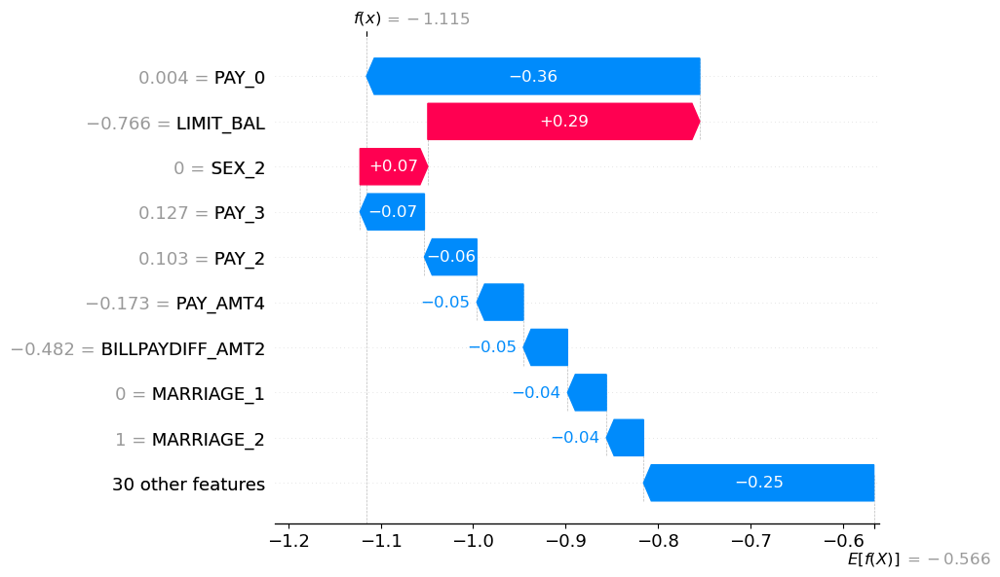

In [35]:
y_test_reset = y_test.reset_index(drop=True)
defaultpay_ind = y_test_reset[y_test_reset == 0].index.tolist()
n_defaultpay_ind = y_test_reset[y_test_reset == 1].index.tolist()

defaultpay_index = defaultpay_ind[10]
n_defaultpay_index = n_defaultpay_ind[10]


pd.DataFrame(
    xgb_explanation[defaultpay_index , :].values,
    index=transformed_columns,
    columns=["SHAP values"],
).sort_values("SHAP values")

shap.initjs()

shap.plots.waterfall(xgb_explanation[defaultpay_index , :])

In [36]:
X_train_enc = pd.DataFrame(
    data=preprocessor.transform(X_train),
    columns=feature_names,
    index=X_train.index,
)
X_train_enc

,standardscaler__LIMIT_BAL,standardscaler__AGE,standardscaler__PAY_0,standardscaler__PAY_2,standardscaler__PAY_3,standardscaler__PAY_4,standardscaler__PAY_5,standardscaler__PAY_6,standardscaler__BILL_AMT1,standardscaler__BILL_AMT2,...,onehotencoder__EDUCATION_3,onehotencoder__EDUCATION_4,onehotencoder__EDUCATION_5,onehotencoder__EDUCATION_6,onehotencoder__MARRIAGE_0,onehotencoder__MARRIAGE_1,onehotencoder__MARRIAGE_2,onehotencoder__MARRIAGE_3,onehotencoder__SEX_2,ordinalencoder__AGE_CATEGORY
7359,-1.134750,1.472763,0.017468,0.113843,0.141836,0.187916,-0.644549,-0.610334,-0.506071,-0.518383,...,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,3.0
16848,-1.134750,0.494186,0.017468,0.113843,0.141836,0.187916,0.235682,0.256207,-0.464977,-0.437462,...,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,2.0
29592,-1.057366,1.472763,0.017468,0.113843,0.141836,1.893979,0.235682,0.256207,-0.351946,-0.325155,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,3.0
20636,-0.515674,-0.593122,0.017468,0.113843,0.141836,0.187916,0.235682,0.256207,0.565909,0.413681,...,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
26275,0.877247,0.167994,-0.872641,-0.720933,-0.693517,-0.665116,0.235682,0.256207,-0.685991,-0.688145,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8144,-0.902597,-1.354237,0.017468,0.113843,1.812542,1.893979,0.235682,0.256207,-0.486160,-0.426288,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
14870,-0.128752,0.929109,0.907578,1.783395,-0.693517,-0.665116,0.235682,0.256207,-0.549463,-0.620053,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,2.0
29361,1.109401,-0.810584,-0.872641,1.783395,-0.693517,-0.665116,-0.644549,0.256207,-0.693476,-0.687890,...,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
9822,-1.134750,1.472763,0.017468,0.113843,0.141836,-0.665116,0.235682,-0.610334,-0.431054,-0.413162,...,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,3.0


In [37]:
xgb_explainer = shap.TreeExplainer(
    pipe_xgb.named_steps["xgbclassifier"],
    data=X_train_enc,
    model_output='predict_proba'
)

shap.plots.force(xgb_explanation[defaultpay_index, :])

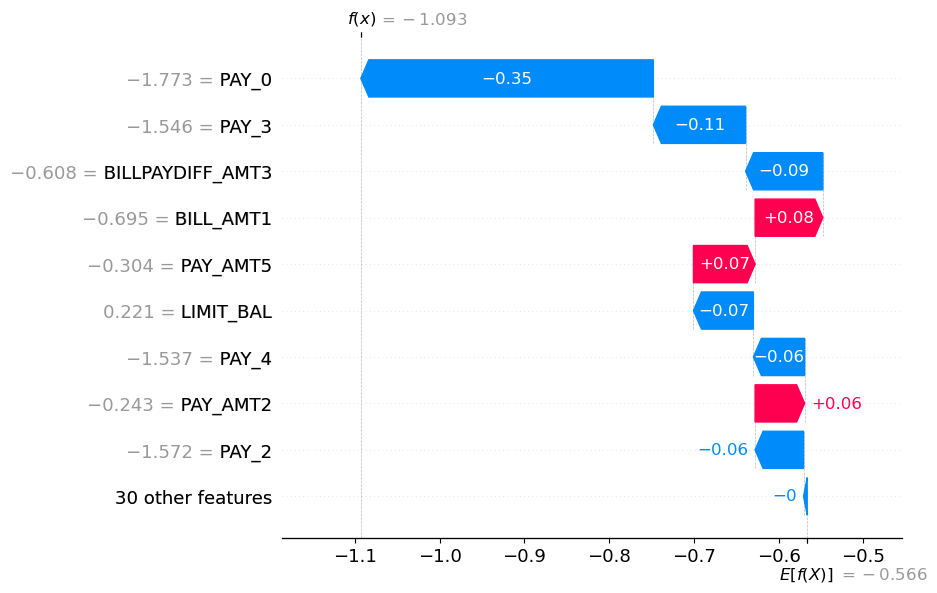

In [38]:
shap.plots.waterfall(xgb_explanation[n_defaultpay_index, :])

In [40]:
shap.plots.force(xgb_explanation[:, :].sample(500))

In [41]:
pd.Series(
    np.abs(xgb_explanation[:, :].values).mean(axis=0),
    index=feature_names
).sort_values()

onehotencoder__EDUCATION_0          0.000000
onehotencoder__MARRIAGE_3           0.000000
onehotencoder__MARRIAGE_0           0.000000
onehotencoder__EDUCATION_6          0.000000
onehotencoder__EDUCATION_3          0.002391
onehotencoder__EDUCATION_4          0.002396
onehotencoder__EDUCATION_2          0.005169
ordinalencoder__AGE_CATEGORY        0.005788
onehotencoder__EDUCATION_1          0.007206
onehotencoder__EDUCATION_5          0.013049
standardscaler__BILL_AMT2           0.013863
standardscaler__BILL_AMT6           0.018362
standardscaler__BILLPAYDIFF_AMT5    0.018481
standardscaler__BILLPAYDIFF_AMT4    0.018535
standardscaler__BILL_AMT5           0.021566
standardscaler__BILLPAYDIFF_AMT6    0.021869
standardscaler__BILL_AMT4           0.026038
standardscaler__AGE                 0.029178
standardscaler__PAY_AMT5            0.033887
onehotencoder__MARRIAGE_2           0.034508
onehotencoder__MARRIAGE_1           0.035257
standardscaler__BILL_AMT3           0.037112
standardsc

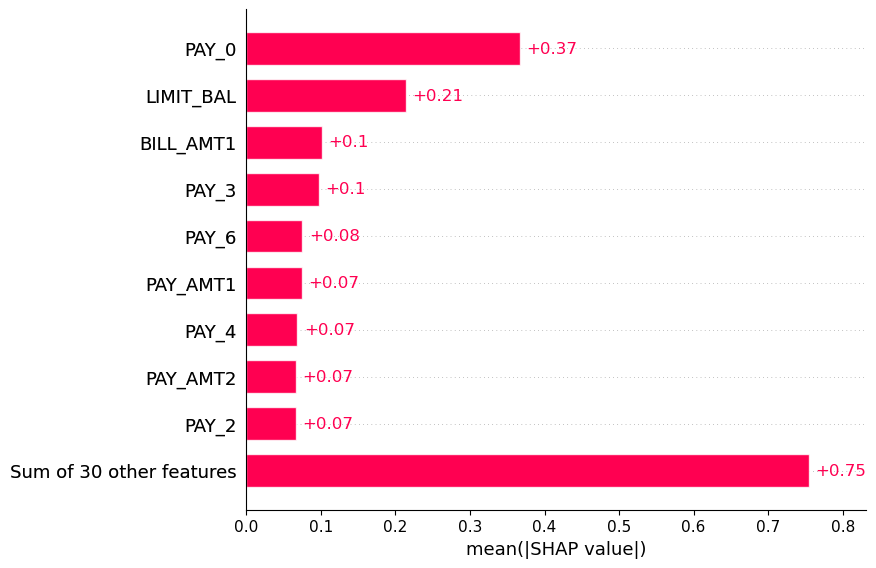

In [42]:
shap.plots.bar(xgb_explanation[:, :])

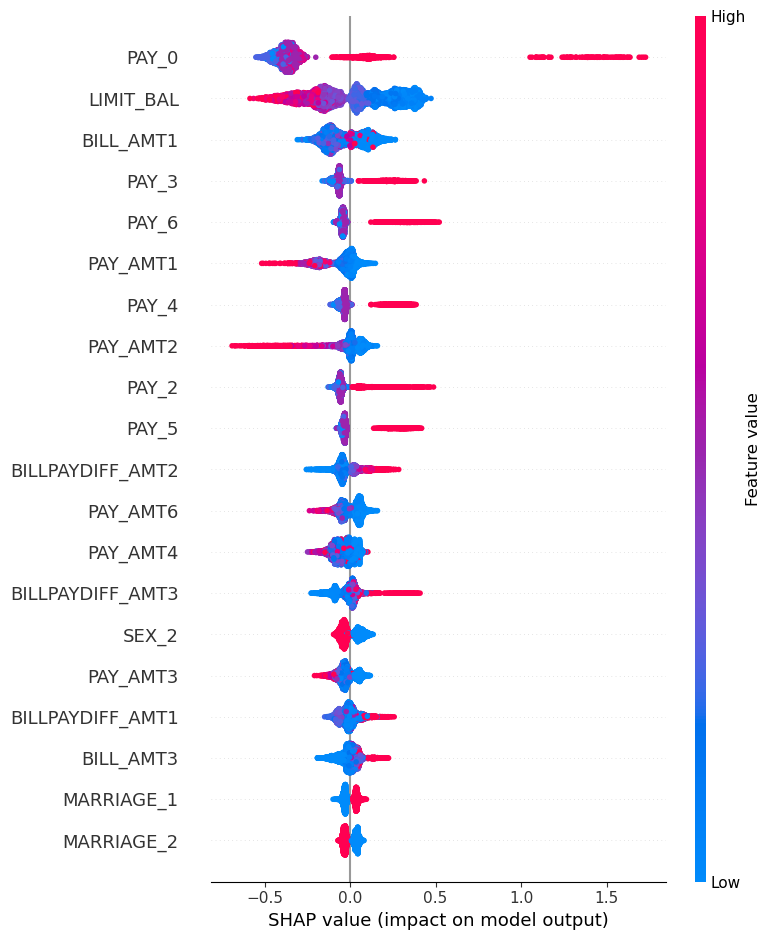

In [43]:
shap.summary_plot(xgb_explanation, transformed_df) 

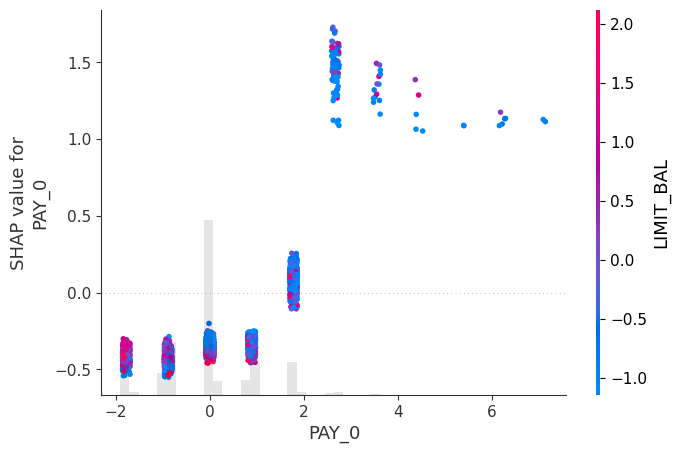

In [51]:
shap.plots.scatter(
    xgb_explanation[:, 'PAY_0'],
    xgb_explanation[:, 'LIMIT_BAL']
)

<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## 12. Results on the test set <a name="12"></a>
rubric={accuracy,reasoning}

**Your tasks:**

1. Try your best performing model on the test data and report test scores. 
2. Do the test scores agree with the validation scores from before? To what extent do you trust your results? Do you think you've had issues with optimization bias? 
3. Take one or two test predictions and explain them with SHAP force plots.  
    
</div>

_Points:_ 6

In [46]:
from sklearn.metrics import classification_report

best_model = random_search_xgb.best_estimator_

predictions = best_model.predict(X_test)

report = classification_report(y_test, predictions, target_names=["No default", "Default"])
print(report)


              precision    recall  f1-score   support

  No default       0.86      0.90      0.88      4646
     Default       0.60      0.51      0.55      1354

    accuracy                           0.81      6000
   macro avg       0.73      0.71      0.72      6000
weighted avg       0.81      0.81      0.81      6000




Yes validation results from before showed 0.534 using the f1 score, now on the test data, the f1 score is 0.55. This shows there is not much optimization bias occuring. This can show that the XGB best model results can be quite reliable. 

In [47]:
#prediction 1 non-default 
y_test_reset = y_test.reset_index(drop=True)

ex_non_default_index =  y_test_reset[y_test_reset == 0].index.tolist()[40]

shap.plots.force(xgb_explanation[ex_non_default_index, :])

The base value is -0.5667  and the force plot shows a raw model score of -1.51, this pushes the prediction towards negative direction. This means this person is likely to not default on their credit payment. The main features, PAY_0 = -1.763 and PAY_2 = -1.556 are the strongest features to push the prediction to not default. 

In [48]:
#prediction 2 default 
y_test_reset = y_test.reset_index(drop=True)

ex_default_index = y_test_reset[y_test_reset == 1].index.tolist()[30]

shap.plots.force(xgb_explanation[ex_default_index, :])

The base value is -0.5667 and the force plot shows a raw model score of 1.01, this pushes the prediction towards positive direction. This means this person is likely to default on their credit payment. The main features, PAY_0 = 3.578 and PAY_3 = 1.813 are the strongest features that push the prediction to default. 

<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-info">

## 13. Summary of results <a name="13"></a>
rubric={reasoning}

Imagine that you want to present the summary of these results to your boss and co-workers. 

**Your tasks:**

1. Create a table summarizing important results. 
2. Write concluding remarks.
3. Discuss other ideas that you did not try but could potentially improve the performance/interpretability . 
3. Report your final test score along with the metric you used at the top of this notebook.
    
</div>

_Points:_ 8

**Concluding Remarks:**</br>
The result of the models we ran shown in the below table. </br>
Comparing the model type we ran, baseline model is getting the worst test score, whereas XGBoost is the best performance model. Each of them are being significant improved by Hyperparameter Tuning. However, Feature Selection makes no significant improvement in test score therefore it is not adapted further. </br> 
The best model is XGBoost with hyperparameter tuning, with test score 0.535 (f1-score). </br></br>
**Other Ideas did not try but with potentials:**</br>
1. Other hyperparameter search strategies beyond RandomSearch should be explored, such as scikit-optimize. However, these methods can be time-consuming to execute on a local laptop.
2. Further feature engineering could be conducted. For instance, based on the SHAP values we observed, the features Education and Marriage do not significantly contribute to the prediction. These features could be considered for removal, especially to address ethical considerations by minimizing social stereotyping.
3. Additional relevant features should be included, such as customers' usages of other banking products and their credit reports.
4. The dataset should be further cleaned. For example, the Education feature includes values like 5 and 6, which are unclear and need clarification.
5. The Sex feature might be excluded to avoid ethical concerns.


In [49]:
result_df = pd.concat(result)
result_df = result_df.reset_index()
result_df.columns = ['Model', 'Metric', 'Mean', 'Std']
result_df = result_df.pivot(index='Model', columns='Metric', values=['Mean', 'Std'])
custom_order = ['DummyRegressor',
                'LogReg',
                'LogReg with Balancing',
                'LogReg with BestParam',
                'RandomForest',
                'RandomForest with FeatSelect',
                'RandomForest with BestParam',
                'Staking LogReg_DTree',
                'XGBoost',
                'XGBoost with FeatSelect',
                'XGBoost with BestParam'
               ]
result_df = result_df.reindex(custom_order)
result_df

Mean                                    \
Metric                        fit_time score_time test_score train_score   
Model                                                                      
DummyRegressor                   0.004      0.004      0.223       0.223   
LogReg                           0.172      0.013      0.351       0.355   
LogReg with Balancing            0.134      0.012      0.474       0.478   
LogReg with BestParam            0.111      0.014      0.476       0.479   
RandomForest                     8.301      0.093      0.457       0.999   
RandomForest with FeatSelect  1134.275      0.101      0.459       0.999   
RandomForest with BestParam    101.672      0.140      0.470       0.871   
Staking LogReg_DTree             4.478      0.013      0.410       0.484   
XGBoost                          0.210      0.020      0.470       0.482   
XGBoost with FeatSelect         16.526      0.017      0.472       0.479   
XGBoost with BestParam           0.360      0.019      0.533       0.571   

                                  Std                                    
Metric                       fit_time score_time test_score train_score  
Model                                                                    
DummyRegressor                  0.001      0.001      0.004       0.003  
LogReg                          0.022      0.002      0.013       0.012  
LogReg with Balancing           0.015      0.002      0.010       0.002  
LogReg with BestParam           0.046      0.003      0.012       0.002  
RandomForest                    0.628      0.007      0.012       0.000  
RandomForest with FeatSelect   39.811      0.005      0.012       0.000  
RandomForest with BestParam     1.096      0.001      0.015       0.003  
Staking LogReg_DTree            0.141      0.002      0.017       0.007  
XGBoost                         0.094      0.003      0.016       0.006  
XGBoost with FeatSelect         0.312      0.003      0.019       0.006  
XGBoost with BestParam          0.050      0.001      0.007       0.003

<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-warning">

## 14. Creating a data analysis pipeline (Challenging)
rubric={reasoning}

**Your tasks:**

- Convert this notebook into scripts to create a reproducible data analysis pipeline with appropriate documentation. Submit your project folder in addition to this notebook on GitHub and briefly comment on your organization in the text box below.
    
</div>

_Points:_ 2

_Type your answer here, replacing this text._

<!-- END QUESTION -->

<!-- BEGIN QUESTION -->

<div class="alert alert-warning">

## 15. Your takeaway from the course (Challenging)
rubric={reasoning}

**Your tasks:**

What is your biggest takeaway from this course? 
    
</div>

_Points:_ 0.25

The most significant takeaway from this course is the crucial role that evaluation metrics and feature engineering play in building effective machine learning models.

- Understanding the Goal (Inference vs. Prediction): The choice of evaluation metrics and feature engineering techniques depends heavily on the goal of the analysis. Is the objective to understand relationships between variables (inference) or to make accurate predictions on new data (prediction)
- Importance of the Right Metric: Accuracy is not always the most informative metric, especially in cases of class imbalance. Metrics like precision, recall, F1-score, and AUC (Area Under the Curve) provide a more nuanced view of model performance, particularly in spotting problems (e.g., fraud detection).
- Considering Multiple Metrics: Reporting multiple metrics, such as precision, recall, and RMSE (Root Mean Squared Error) for regression problems, provides a comprehensive assessment of the model's performance.●
- Feature Engineering is Key: Feature engineering, the process of transforming raw data into features suitable for machine learning, can significantly improve model performance. It involves techniques such as:○
- Polynomial Feature Transformations: Capture non-linear relationships.
- Feature Crosses: Encode interactions between features.
- Text Data Engineering: Using tools like spaCy and nltk to extract meaningful features (e.g., sentiment, length) from text.
- Data Quality Matters: No matter how advanced the model, its performance is limited by the quality of the data. Data cleaning and addressing issues like class imbalance are essential.
- Model Interpretability: Feature selection techniques (e.g., model-based selection, recursive feature elimination) help identify the most important features, leading to more interpretable models.

Overall, this course emphasizes a data-centric approach to machine learning, highlighting the importance of understanding data, selecting appropriate evaluation metrics, and carefully engineering features to build models that are both effective and insightful.

<!-- END QUESTION -->

<div class="alert alert-danger" style="color:black">
    
**Restart, run all and export a PDF before submitting**
    
Before submitting,
don't forget to run all cells in your notebook
to make sure there are no errors
and so that the TAs can see your plots on Gradescope.
You can do this by clicking the ▶▶ button
or going to `Kernel -> Restart Kernel and Run All Cells...` in the menu.
This is not only important for MDS,
but a good habit you should get into before ever committing a notebook to GitHub,
so that your collaborators can run it from top to bottom
without issues.
    
After running all the cells,
export a PDF of the notebook (preferably the WebPDF export)
and upload this PDF together with the ipynb file to Gradescope
(you can select two files when uploading to Gradescope)
</div>

---

## Help us improve the labs

The MDS program is continually looking to improve our courses, including lab questions and content. The following optional questions will not affect your grade in any way nor will they be used for anything other than program improvement:

1. Approximately how many hours did you spend working or thinking about this assignment (including lab time)?

#Ans:

2. Do you have any feedback on the lab you be willing to share? For example, any part or question that you particularly liked or disliked?

#Ans: